In [19]:
import os
import numpy as np
import pandas as pd
import scipy
from pandas import DataFrame
from pandas import read_csv
import matplotlib.pyplot as plt
import glob

In [20]:
normalization_method = "min_max"
# normalization_method = "pdf90"

# 读取数据

In [3]:
# load KPIs files from a folder
# files = glob.glob("data/data_wide_pdf90.csv")
# dfs = [pd.read_csv(fp,encoding = 'gbk', low_memory=False) for fp in files]
# df_raw = pd.concat(dfs, ignore_index=True)
df_raw = pd.read_csv("data/data_wide_{}.csv".format(normalization_method), encoding='gbk', low_memory=False)
df_raw = df_raw.iloc[3:,:].reset_index().drop(['index'], axis=1)
df_raw.rename(columns={'Unnamed: 0':'cell'}, inplace = True)
df_raw.set_index('cell', inplace = True)
df_raw = df_raw.astype("float32")
df_raw.head()

,Users_RRC_Avg,Users_RRC_Avg.1,Users_RRC_Avg.2,Users_RRC_Avg.3,Users_RRC_Avg.4,Users_RRC_Avg.5,Users_RRC_Avg.6,Users_RRC_Avg.7,Users_RRC_Avg.8,Users_RRC_Avg.9,...,SRfail_RAatt.14,SRfail_RAatt.15,SRfail_RAatt.16,SRfail_RAatt.17,SRfail_RAatt.18,SRfail_RAatt.19,SRfail_RAatt.20,SRfail_RAatt.21,SRfail_RAatt.22,SRfail_RAatt.23
cell,,,,,,,,,,,,,,,,,,,,,
LA3LK31B,0.205038,0.161239,0.140361,0.124248,0.116873,0.106661,0.111653,0.121866,0.053898,0.053557,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LA3LK31D,0.290707,0.242370,0.214002,0.165778,0.150233,0.135255,0.152275,0.174969,0.089981,0.091342,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LA3LK31E,0.081130,0.066379,0.063543,0.046182,0.033700,0.036991,0.052763,0.068535,0.051628,0.063543,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LD31A01B,0.131624,0.098604,0.088279,0.079428,0.077386,0.095995,0.133099,0.233859,0.266538,0.268127,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LD31A03A,0.042324,0.026438,0.026438,0.028367,0.042551,0.047770,0.072166,0.226711,0.257347,0.217179,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
kpi_list = ['Users_RRC_Avg', 'PDSCH_Usage_DL', 'PDCCH_CCE_Above_70', 'DL_Volume_GB', 'PUSCH_Usage_UL', 'UL_Volume_GB',
       'RLC_Time_Delay', 'User_THP_DL_kbps', 'User_THP_UL_kbps','Cell_THP_Dl_kbps', 'Cell_THP_UL_kbps',
       'MAC_Retransmission_DL', 'MAC_Retransmission_UL', 'SRfail_RAatt']
# 'RLC_Retransmission_DL', 'RLC_Retransmission_UL'
feature_data = np.array(df_raw)
df_cellname = df_raw.index.values

nb_kpis = len(kpi_list)  # 关键指标个数
nb_hours = 24  # 小时数
nb_features = nb_kpis * nb_hours  # 变量个数

# 建立autoencoder进行异常值检测

In [5]:
from sklearn.model_selection import train_test_split
from keras.layers import Input, Dense, Lambda, Layer
from keras.models import Model, load_model
from keras import backend as K
from keras import metrics

Using TensorFlow backend.


In [6]:
def fit_model(feature_data, test_size):
    x_train, x_test = train_test_split(feature_data, test_size=0.20, random_state=42)

    # Model parameters
    batch_size = 200
    epochs = 80
    
    input_img = Input(shape=(nb_features,))
    encoded = Dense(64, activation='relu')(input_img)
    encoded = Dense(32, activation='relu')(encoded)
    encoded = Dense(16, activation='relu')(encoded)

    decoded = Dense(16, activation='relu')(encoded)
    decoded = Dense(32, activation='relu')(decoded)
    decoded = Dense(nb_features, activation='sigmoid')(decoded)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy', metrics=['mae', 'mse', 'acc'])

    autoencoder.fit(x_train, x_train,
                       epochs=epochs,
                       batch_size=batch_size,
                       shuffle=True,
                       verbose=False,
                       validation_data=(x_test, x_test))
    autoencoder.save(model_path)
    return autoencoder
# Save model
# autoencoder.save("model/{}_{}.h5".format(model_))

# Save training history
# fileObject = open((ae_model_name + '_hist'),'wb') # open the file for writing training history
# pickle.dump(ae_hist, fileObject)
# fileObject.close()

model_path = os.path.join("model", "autoencoder_{}.h5".format(normalization_method))
if not os.path.exists(model_path):
    autoencoder = fit_model(feature_data, test_size=0.2)
else:
    autoencoder = load_model(model_path)
    print("the model was existed and directly load it")

the model was existed and directly load it


In [7]:
# 定义异常数据
outlier_quantile = 98
predictions = autoencoder.predict(feature_data)
mse = np.mean(np.power(feature_data - predictions, 2), axis=1)  # Compute reconstruction error

outlier_threshold = np.percentile(mse, outlier_quantile)
print(outlier_threshold)

outlier_data = feature_data[np.where(mse > outlier_threshold)[0],:]
normal_data = feature_data[np.where(mse <= outlier_threshold)[0],:]

outlier_cellname =  df_cellname[np.where(mse > outlier_threshold)]
outlier_mse = mse[np.where(mse > outlier_threshold)]

print("# of outlier data: {}".format(outlier_data.shape[0]))

0.115160546899
# of outlier data: 369


In [8]:
df_outlier = df_raw[df_raw.index.isin(outlier_cellname)].copy()
df_outlier.to_csv("data/df_outlier.csv")

## 对异常数据进行聚类

In [9]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

Text(0.5,1,'data distribution aftet tsne')

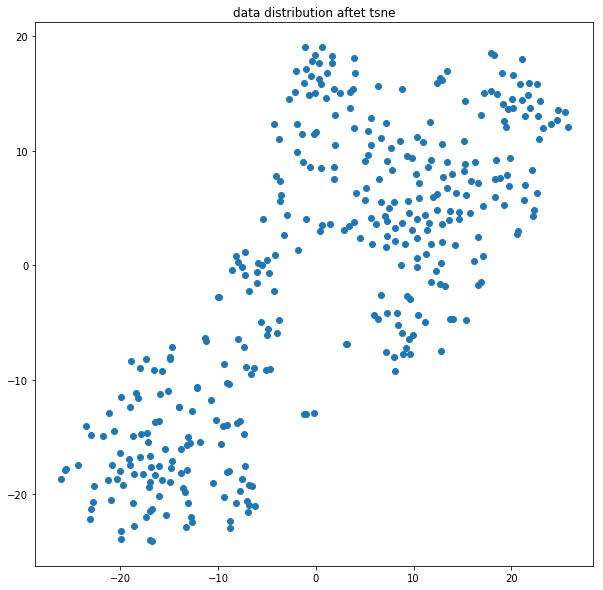

In [10]:
# 观察数据tsne-2d图判断合适的分类簇数
data_pca= PCA(n_components=60).fit_transform(outlier_data)
data_pca_tsne = TSNE(n_components=2).fit_transform(outlier_data)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
ax.scatter(data_pca_tsne[:, 0], data_pca_tsne[:, 1])
ax.set_title("data distribution aftet tsne")

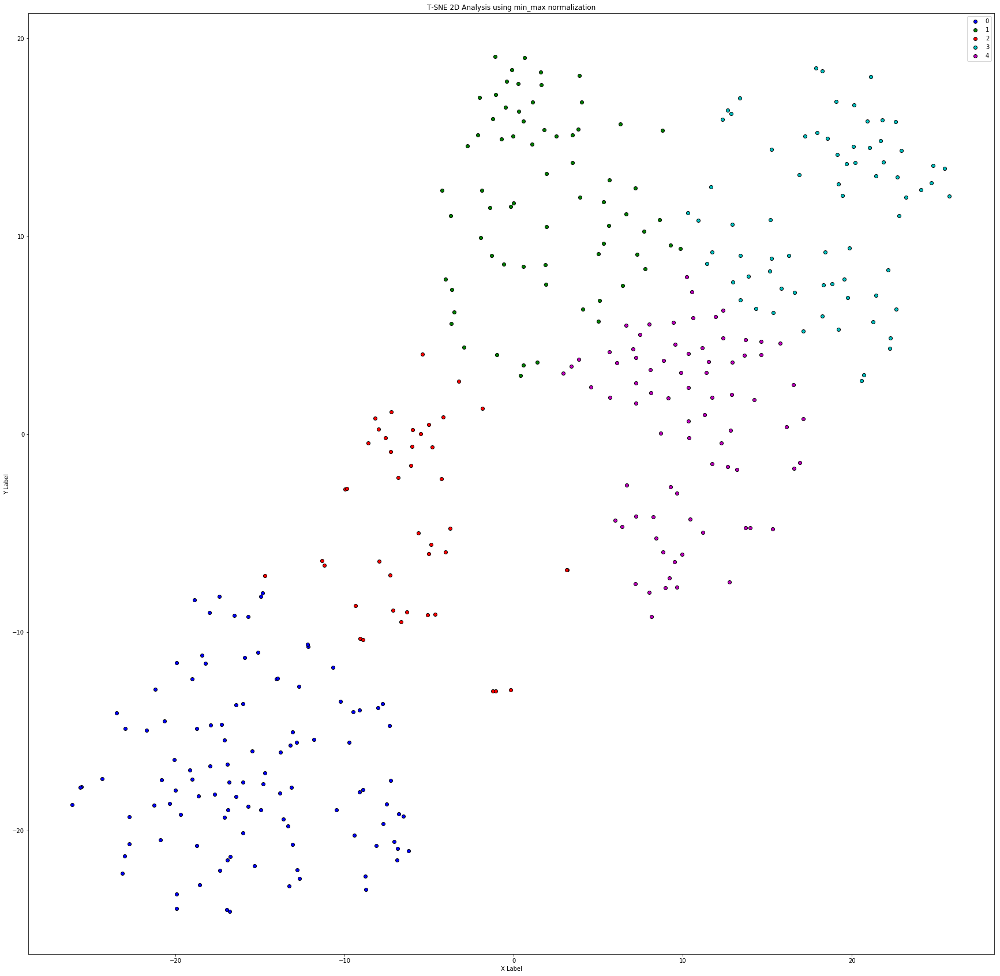

In [23]:
# data_pca= PCA(n_components=60).fit_transform(outlier_data)
# data_pca_tsne = TSNE(n_components=2).fit_transform(data_pca)

numClusters = {"min_max": 5, "pdf_90":3}

# Compute k-means clustering
kmeans = KMeans(n_clusters=numClusters[normalization_method])
kmeans.fit(data_pca_tsne)

km_centroids = kmeans.cluster_centers_
km_labels = kmeans.labels_

# 2-dim scatter plot
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(30, 30))

colors=['b','g','r','c','m','y','k','chocolate','gold','lightgrey', 'skyblue', 'lime']

for i in range(numClusters[normalization_method]):
    ax.scatter(data_pca_tsne[km_labels==i, 0], data_pca_tsne[km_labels==i, 1], 
           c=colors[i], edgecolor='k', label=i)

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')

ax.set_title('T-SNE 2D Analysis using {} normalization'.format(normalization_method))
ax.legend()
# for i, cell_name in enumerate(outlier_cellname):
#     ax.annotate(cell_name, (data_pca_tsne[i, 0], data_pca_tsne[i, 1]))
plt.savefig("plots/tsne_analysis_using_{}.png".format(normalization_method))
plt.show()

In [14]:
import matplotlib as mpl
import os
if not os.path.exists("class_map_plots"):
    os.makedirs("class_map_plots")
# Plot abnormal patterns
for label in range(numClusters[normalization_method]):
    print("cluster: ", label)
    label_pattern_data = outlier_data[np.where(km_labels==label)[0],:]
    label_cellname_data = outlier_cellname[np.where(km_labels==label)[0]]
    label_mse_data = outlier_mse[np.where(km_labels==label)[0]]
    num_limit_cell_per_pdf = 100
    n = label_pattern_data.shape[0]  # how many ouliers we will display
    batch = np.ceil(n / num_limit_cell_per_pdf)  # 保证每个pdf最多显示80个小区 过多会出现截断
    label_pattern_data = label_pattern_data.reshape(label_pattern_data.shape[0],nb_kpis,nb_hours, 1)
    n_col = 2
    n_row = np.ceil(n / n_col)
    for part in range(int(batch)):
        print("part", part)
#         f = plt.figure(figsize=(n_row*0.8 , n_row * 5))
        st = part * num_limit_cell_per_pdf
        if part == (batch - 1):
            end = n
        else:
            end = (part + 1) * num_limit_cell_per_pdf
        for i in range(st, end):
            print(i)

cluster:  0
part 0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
part 1
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
part 2
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
cluster:  1
part 0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55


# 生成分析图谱

cluster:  0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
cluster:  1
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
6

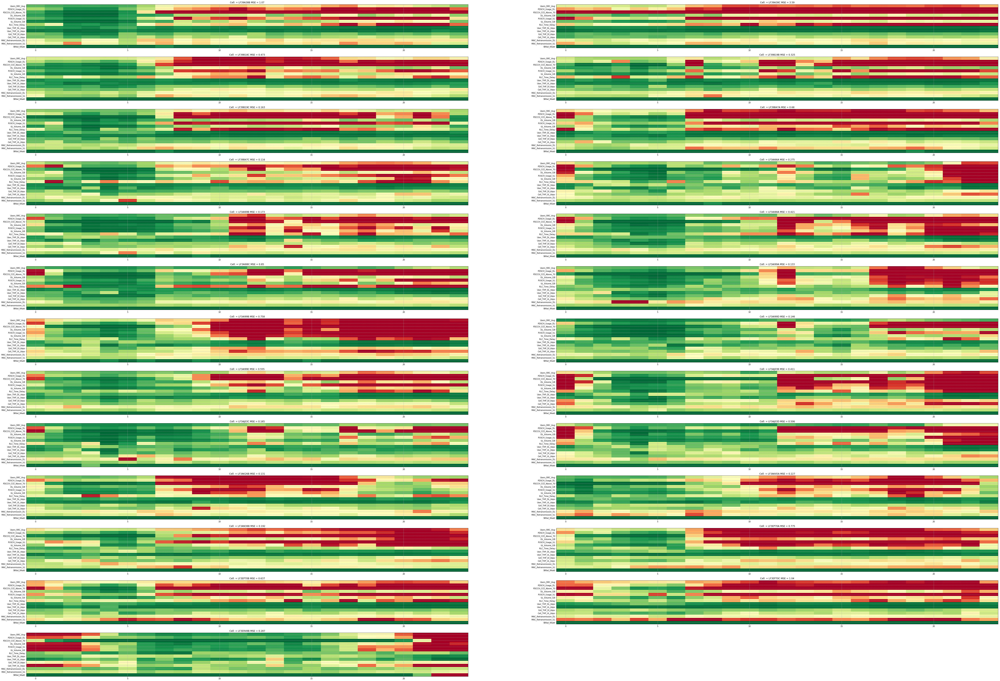

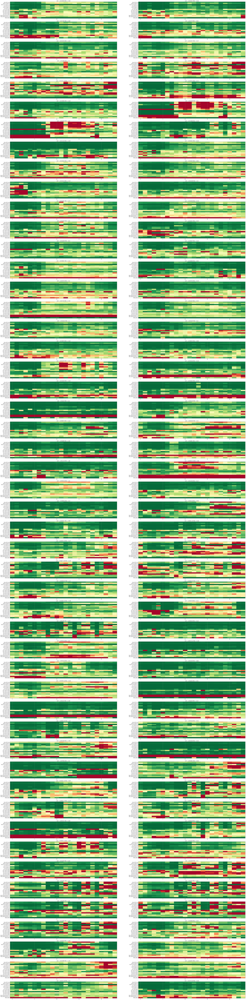

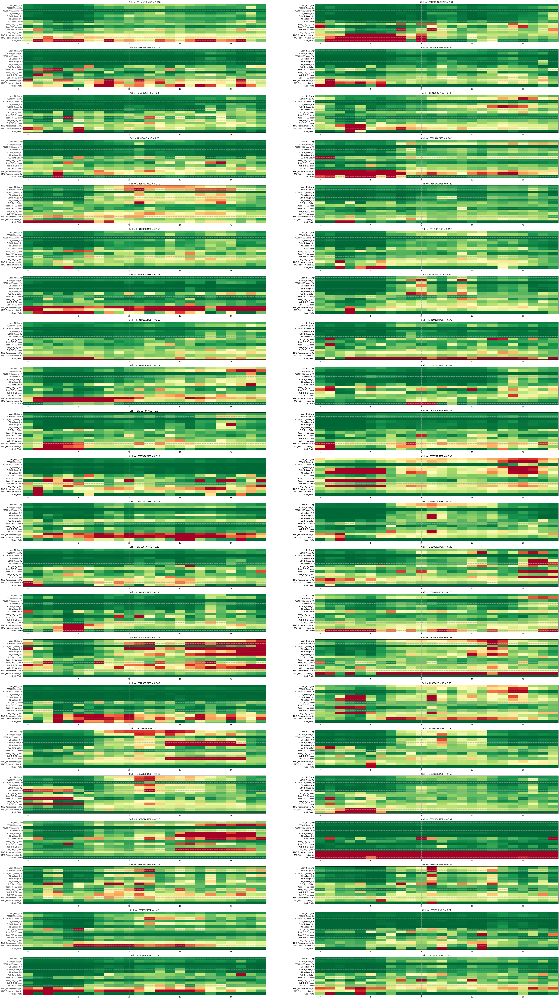

In [12]:
import matplotlib as mpl
import os
if not os.path.exists("class_map_plots"):
    os.makedirs("class_map_plots")
# Plot abnormal patterns
for label in range(numClusters[normalization_method]):
    print("cluster: ", label)
    label_pattern_data = outlier_data[np.where(km_labels==label)[0],:]
    label_cellname_data = outlier_cellname[np.where(km_labels==label)[0]]
    label_mse_data = outlier_mse[np.where(km_labels==label)[0]]
    num_limit_cell_per_pdf = 100
    n = label_pattern_data.shape[0]  # how many ouliers we will display
    batch = np.ceil(n / num_limit_cell_per_pdf)  # 保证每个pdf最多显示80个小区 过多会出现截断
    label_pattern_data = label_pattern_data.reshape(label_pattern_data.shape[0],nb_kpis,nb_hours, 1)
    n_col = 2
    n_row = np.ceil(n / n_col)
    for part in range(int(batch)):
        f = plt.figure(figsize=(n_row*0.8 , n_row * 5))
        st = part * num_limit_cell_per_pdf
        if part == (batch - 1):
            end = n
        else:
            end = (part + 1) * num_limit_cell_per_pdf
        for i in range(st, end):
            print(i)
            # display original
            ax = plt.subplot(n_row, n_col, i + 1)
            plt.imshow(label_pattern_data[i,:,:,0],norm=mpl.colors.Normalize(vmin=0, vmax=1), interpolation='None', cmap=plt.cm.get_cmap('RdYlGn_r'),aspect='auto')
    #         ax.get_xaxis().set_visible(False)
    #         ax.get_yaxis().set_visible(False)
        #     ax.set_title(label_pattern_data[i])
    #         plt.colorbar()
            plt.yticks(range(len(kpi_list)), kpi_list)
            plt.title('Cell: = {0} MSE = {1:.3g}'.format(label_cellname_data[i],label_mse_data[i]))
            plt.grid(b=True, which='both', color='0.65', linestyle='--')
    #     plt.show()

        f.savefig("class_map_plots/high_load_{}_class0{}_part{}.pdf".format(normalization_method, str(label), str(part)), bbox_inches='tight')

In [ ]:
km_labels.